## Методические указания по выполнению лабораторной работы №5

**Тема: Обучение модели YOLO на кастомном датасете и исследование влияния гиперпараметров на качество детекции**

**Цель работы:** Познакомиться с архитектурой YOLO на примере проверки гипотезы о релевантной метрике.

**Задачи:**

- Ознакомиться с архитектурой YOLO.
- Изучить метрики для анализа производительности модели, выбрать целевую метрику в соответствии с вариантом.
- Выбрать предметную область, сформировать гипотезу для проведения исследования.
- Собрать и проаннотировать данные, сформировать датасет.
- Провести fine-tuning предобученной модели YOLOv11 Nano/Small.
- Визуализировать и проанализировать результаты.
- На основе анализа сделать корректировку гиперпараметров/данных и провести вторую итерацию для повышения показателей.

### 1. Подготовка к обучению

#### 1.1 Метрики

Вариант 1 - Precision

Вариант 2 - Recall

Вариант 3 - F1 

Вариант 4 - mAP@0.5

Вариант 5 - mAP@0.75


#### 1.2 Гипотеза

Гипотеза должна отражать характер уклона исследования с обоснованием, отталкиваясь от предметной области. *Одна лишь констатация необходимости достижения высокого значения целевой метрики не является обоснованием*.

#### 1.3 Данные

Соберите не менее 500 изображений из открытых источников. Можно пользоваться готовыми наборами данных, но важно проверить качество: разрешение изображений, качество аннотаций, баланс классов. При самостоятельном сборе данных можете воспользоваться терминальной утилитой ffmpeg для нарезки видео на кадры и любым удобным инструментом аннотирования (Roboflow, CVAT и тд). 

#### 1.4 Предобработка

Примените методы аугментации к данным для расширения объема датасета для получения 1.5-2к изображений. Подготовьте данные к требуемому формату для обучающего процесса.

#### 1.5 Вариант

Вариант 4 - mAP@0.5


### 2. Обучение модели

#### 2.1 Подготовка окружения

Установите зависимости и библиотеки:

In [67]:
%pip install -U ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6362.0/8062.4 GB disk)


In [68]:
# !pip install -U ipywidgets

import numpy as np 
import pandas as pd

import os

from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

import glob


Функция для визуализации результата обучения или валидации

In [69]:
def visualize_results(save_dir_path):
    
    files = glob.glob(os.path.join(save_dir_path, '*.png')) + glob.glob(os.path.join(save_dir_path, '*.jpg'))
    
    for fname in files:
        if os.path.exists(fname):
            img = Image.open(fname)
            plt.figure(figsize=(10, 10))
            plt.title(os.path.basename(fname))
            plt.imshow(img)
            plt.axis("off")
            plt.show()
        else:
            print(f"⚠️ File not found: {fname}")

#### 2.2 Подготовка модели

Загрузите предобученную модель, определите устройство, переведите модель в режим инференса. Не используйте размер модели больше чем Small для достижения лучших показателей на стандартных гиперпараметрах (особенно imgsz)


image 1/1 /kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg: 640x640 1 bird, 9.1ms
Speed: 1.8ms preprocess, 9.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


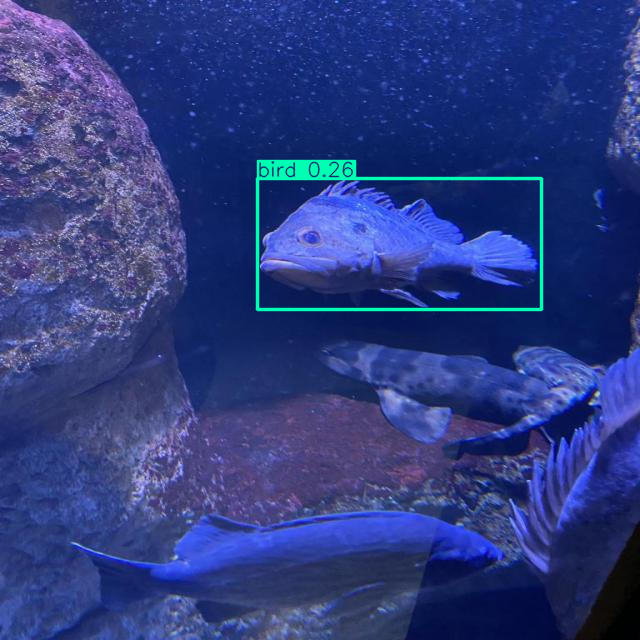

In [70]:
#импорт модели
model = YOLO("yolo11n.pt")
img="/kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
# img = "dataset/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
model.predict(img)[0].show()

#### 2.3 Загрузка и предобработка изображений


Затем импортируйте датасет в проект и выполните трансформацию данных (при использовании Roboflow трансформация выполняется на этапе предобработки):

In [5]:
# загрузка датасета
# dataset_path : /kaggle/input/augumented-underwater-objects
# link to dataset: https://www.kaggle.com/datasets/rustamshamsutdinov/augumented-underwater-objects

# метод трансформации


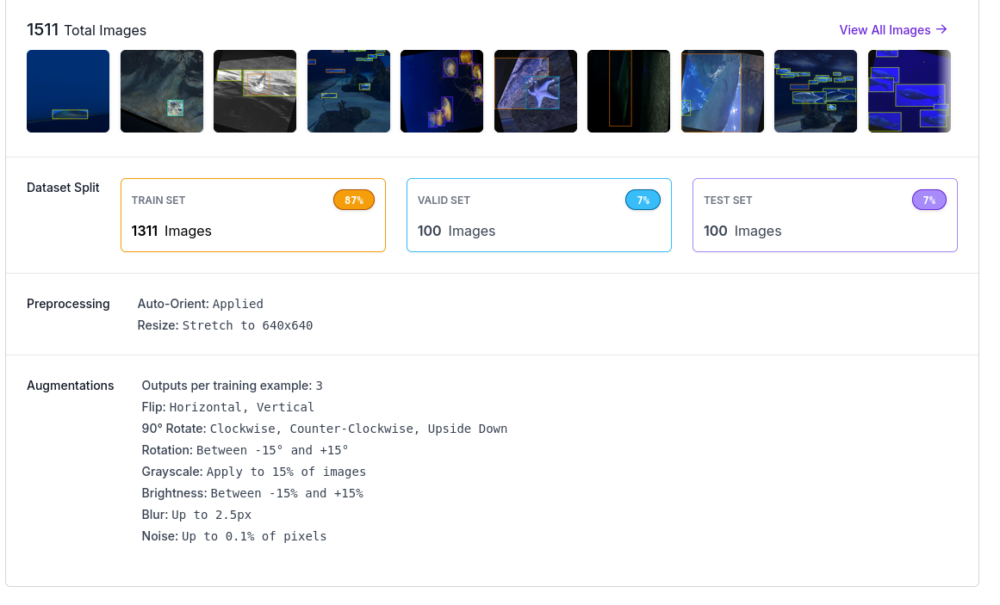

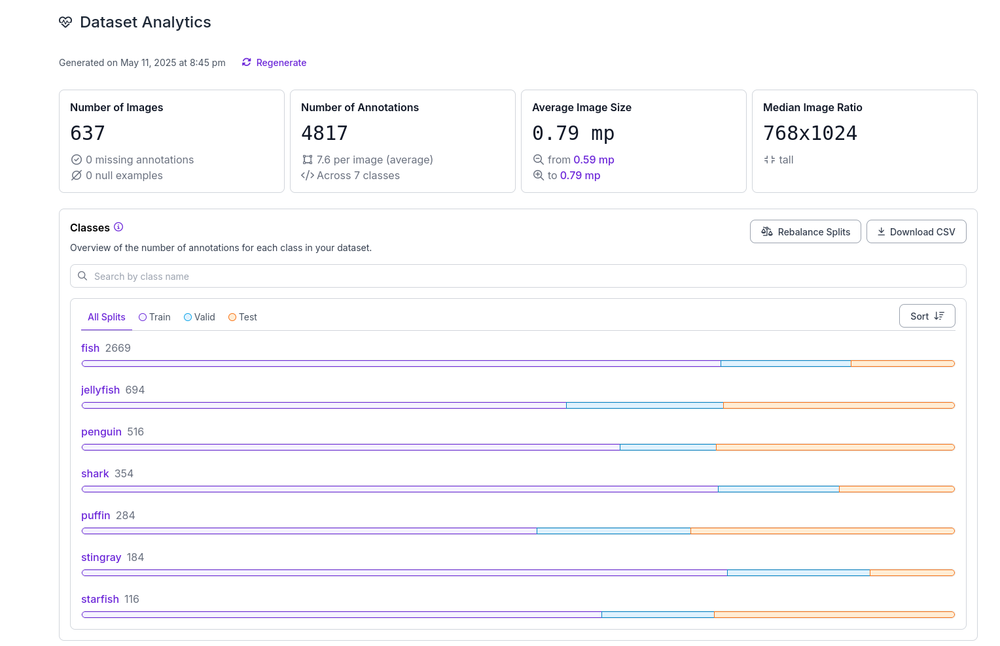

Пример аугументированного изображения

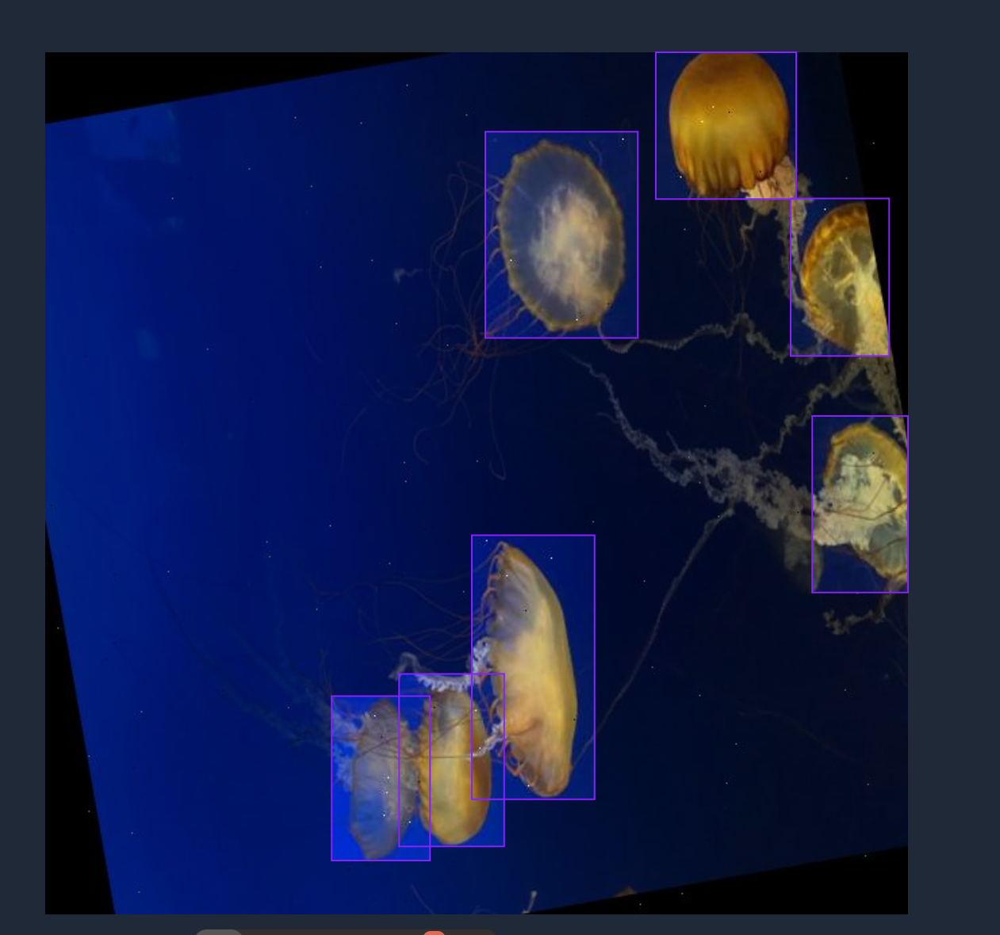

#### 2.4 Обучение, оценка модели и визуализация результатов

Проведите обучение модели, проанализируйте кривые обучения, метрики и тестовые данные. Сделайте вывод и корректироваки для достижения лучших показателей

In [10]:
data_kaggel_path = "/kaggle/input/augumented-underwater-objects/data.yaml"
# data_local_path = "dataset/data.yaml"
firts_results = model.train(
    data=data_kaggel_path,
    epochs=50,
    imgsz=640,
    plots=True,
    seed=42,
    cache='disk',
    batch=-1,
    save=True,
    save_period=10,
    close_mosaic=0
)

Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=-1, bgr=0.0, box=7.5, cache=disk, cfg=None, classes=None, close_mosaic=0, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/augumented-underwater-objects/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=Tru

train: Scanning /kaggle/input/augumented-underwater-objects/train/labels... 1311 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1311/1311 [00:01<00:00, 923.16it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/augumented-underwater-objects/train is not writeable, cache not saved.
WARNING ⚠️ train: Skipping caching images to disk, directory not writeable
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
AutoBatch: Computing optimal batch size for imgsz=640 at 60.0% CUDA memory utilization.
AutoBatch: CUDA:0 (Tesla T4) 14.74G total, 8.04G reserved, 0.62G allocated, 6.08G free


      Params      GFLOPs  GPU_mem (GB)  forward (ms) backward (ms)                   input                  output
     2591205       6.447         1.571         32.27         25.77        (1, 3, 640, 640)                    list
     2591205       12.89         1.736         28.26         28.44        (2, 3, 640, 640)                    list
     2591205       25.79         2.076         31.43         29.92        (4, 3, 640, 640)                    list
     2591205       51.58         2.728         33.67         40.08        (8, 3, 640, 640)                    list
     2591205       103.2         3.995         41.13         73.71       (16, 3, 640, 640)                    list
AutoBatch: Using batch-size 15 for CUDA:0 12.50G/14.74G (85%) ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 70.9±24.8 MB/s, size: 46.5 KB)


train: Scanning /kaggle/input/augumented-underwater-objects/train/labels... 1311 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1311/1311 [00:01<00:00, 1060.19it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/augumented-underwater-objects/train is not writeable, cache not saved.
WARNING ⚠️ train: Skipping caching images to disk, directory not writeable
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.6±0.2 ms, read: 77.0±31.3 MB/s, size: 63.7 KB)


val: Scanning /kaggle/input/augumented-underwater-objects/valid/labels... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<00:00, 836.12it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/augumented-underwater-objects/valid is not writeable, cache not saved.
WARNING ⚠️ val: Skipping caching images to disk, directory not writeable


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000909, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.00046875), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      3.22G      2.667      4.115      2.419         31        640: 100%|██████████| 88/88 [00:16<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]

                   all        100        723       0.67     0.0472     0.0471     0.0229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50       3.6G      2.231      3.146      1.914         54        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.21it/s]

                   all        100        723      0.585      0.174      0.177     0.0834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50       3.6G      2.066      2.719      1.762         76        640: 100%|██████████| 88/88 [00:14<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.95it/s]

                   all        100        723      0.519      0.319      0.271      0.135



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       3.6G      1.982      2.504      1.683        131        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.36it/s]

                   all        100        723      0.493      0.317      0.328      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50       3.6G       1.92      2.336      1.596         67        640: 100%|██████████| 88/88 [00:14<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.91it/s]

                   all        100        723      0.452      0.354      0.348      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       3.6G      1.891      2.247      1.581         90        640: 100%|██████████| 88/88 [00:14<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.97it/s]

                   all        100        723      0.418      0.383       0.37      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       3.6G       1.87       2.14      1.558         82        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.89it/s]

                   all        100        723       0.56       0.48      0.481      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       3.6G      1.845      2.072      1.533         58        640: 100%|██████████| 88/88 [00:14<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.06it/s]

                   all        100        723      0.572      0.511      0.512       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       3.6G      1.819      1.978      1.498         30        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.07it/s]

                   all        100        723      0.645      0.525      0.569      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       3.6G      1.778      1.922      1.476         58        640: 100%|██████████| 88/88 [00:14<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.33it/s]

                   all        100        723      0.572      0.492      0.561      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       3.6G      1.761       1.86      1.464        110        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.85it/s]

                   all        100        723      0.679      0.477      0.584      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       3.6G       1.76      1.806      1.455         67        640: 100%|██████████| 88/88 [00:14<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.16it/s]

                   all        100        723      0.581      0.586      0.603      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       3.6G      1.723      1.764      1.434         46        640: 100%|██████████| 88/88 [00:14<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.18it/s]

                   all        100        723      0.675      0.544      0.595      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       3.6G      1.733      1.723      1.434         86        640: 100%|██████████| 88/88 [00:14<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.05it/s]

                   all        100        723      0.677      0.634      0.671      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50       3.6G      1.725      1.698      1.426         86        640: 100%|██████████| 88/88 [00:14<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.17it/s]

                   all        100        723      0.659      0.555      0.625      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       3.6G      1.713      1.643      1.421         77        640: 100%|██████████| 88/88 [00:14<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.07it/s]

                   all        100        723      0.674        0.6      0.682      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       3.6G      1.682      1.616      1.395         47        640: 100%|██████████| 88/88 [00:14<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.19it/s]

                   all        100        723      0.688      0.611      0.683      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       3.6G      1.694      1.623        1.4         31        640: 100%|██████████| 88/88 [00:14<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.10it/s]

                   all        100        723      0.701      0.667      0.698      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       3.6G       1.67      1.563      1.382         41        640: 100%|██████████| 88/88 [00:14<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.23it/s]

                   all        100        723      0.715      0.576      0.669      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       3.6G      1.655      1.531      1.372         87        640: 100%|██████████| 88/88 [00:14<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.32it/s]

                   all        100        723      0.696      0.659      0.698       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       3.6G      1.656      1.554      1.374         38        640: 100%|██████████| 88/88 [00:14<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.35it/s]

                   all        100        723      0.761      0.582      0.704      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       3.6G      1.623      1.498       1.35         75        640: 100%|██████████| 88/88 [00:14<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.48it/s]

                   all        100        723      0.709      0.647       0.72        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       3.6G      1.644      1.481      1.364         53        640: 100%|██████████| 88/88 [00:14<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.14it/s]

                   all        100        723      0.677      0.703      0.727      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       3.6G      1.617      1.458      1.353         94        640: 100%|██████████| 88/88 [00:14<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.34it/s]

                   all        100        723      0.756      0.633      0.731      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       3.6G      1.623      1.453      1.355        112        640: 100%|██████████| 88/88 [00:14<00:00,  5.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.43it/s]

                   all        100        723      0.809      0.607       0.71      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       3.6G      1.611      1.409      1.338         52        640: 100%|██████████| 88/88 [00:14<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.17it/s]

                   all        100        723      0.755      0.657       0.75      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50       3.6G      1.598      1.416      1.339         24        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.16it/s]

                   all        100        723      0.696      0.674      0.734      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       3.6G      1.619      1.419       1.35         21        640: 100%|██████████| 88/88 [00:14<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.38it/s]

                   all        100        723      0.752      0.658      0.744       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       3.6G      1.592        1.4      1.343         58        640: 100%|██████████| 88/88 [00:14<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.98it/s]

                   all        100        723      0.739      0.672      0.715      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       3.6G      1.573      1.374      1.322         80        640: 100%|██████████| 88/88 [00:14<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.54it/s]

                   all        100        723      0.725      0.661      0.728      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       3.6G      1.558      1.352      1.311         57        640: 100%|██████████| 88/88 [00:14<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.46it/s]

                   all        100        723      0.769      0.686      0.743      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       3.6G      1.568      1.329      1.309         32        640: 100%|██████████| 88/88 [00:14<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.30it/s]

                   all        100        723      0.707      0.695      0.737      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50       3.6G      1.571      1.335      1.311         64        640: 100%|██████████| 88/88 [00:14<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.75it/s]

                   all        100        723      0.758      0.694      0.743      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       3.6G      1.536      1.325      1.309         79        640: 100%|██████████| 88/88 [00:14<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.47it/s]

                   all        100        723      0.772      0.665      0.756      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       3.6G      1.557      1.298      1.303         73        640: 100%|██████████| 88/88 [00:14<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.61it/s]

                   all        100        723      0.748      0.707      0.747      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50       3.6G      1.543      1.287      1.301         78        640: 100%|██████████| 88/88 [00:14<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.36it/s]

                   all        100        723       0.75      0.681      0.751      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       3.6G       1.53      1.281       1.29         62        640: 100%|██████████| 88/88 [00:14<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.51it/s]

                   all        100        723      0.782      0.662      0.739      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       3.6G      1.525      1.246      1.289         60        640: 100%|██████████| 88/88 [00:14<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.32it/s]

                   all        100        723      0.806      0.696      0.764      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50       3.6G      1.527      1.235      1.277         70        640: 100%|██████████| 88/88 [00:14<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.37it/s]

                   all        100        723      0.781       0.68      0.754      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       3.6G      1.526      1.246      1.283         41        640: 100%|██████████| 88/88 [00:14<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.06it/s]

                   all        100        723       0.73       0.71      0.749      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50       3.6G      1.508      1.233      1.284        120        640: 100%|██████████| 88/88 [00:14<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.27it/s]

                   all        100        723      0.766      0.711       0.76      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50       3.6G      1.504      1.233      1.276         50        640: 100%|██████████| 88/88 [00:14<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.24it/s]

                   all        100        723      0.719      0.698      0.754      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       3.6G      1.514      1.236      1.282         96        640: 100%|██████████| 88/88 [00:14<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.03it/s]

                   all        100        723      0.742      0.726      0.766      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       3.6G      1.511      1.213      1.285         53        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]

                   all        100        723      0.762      0.719      0.773      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50       3.6G      1.485      1.227      1.274         58        640: 100%|██████████| 88/88 [00:14<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.31it/s]

                   all        100        723      0.761      0.719      0.773      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50       3.6G      1.494        1.2       1.26         48        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.40it/s]

                   all        100        723      0.753      0.735       0.78      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50       3.6G      1.482      1.181      1.262         71        640: 100%|██████████| 88/88 [00:14<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]

                   all        100        723      0.752      0.732      0.775      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50       3.6G      1.497      1.203       1.27         60        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.46it/s]

                   all        100        723       0.77      0.733      0.778      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       3.6G      1.481      1.179      1.255         34        640: 100%|██████████| 88/88 [00:14<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.27it/s]

                   all        100        723      0.746      0.739      0.776      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       3.6G      1.473      1.177      1.263         81        640: 100%|██████████| 88/88 [00:14<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.55it/s]

                   all        100        723      0.759      0.731      0.777      0.453



50 epochs completed in 0.217 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 5.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all        100        723      0.775       0.73      0.778      0.458
                  fish         54        397      0.814      0.685       0.81      0.443
             jellyfish          7        125      0.822      0.912       0.92       0.55
               penguin         11         57       0.62      0.667      0.652      0.273
                puffin         11         50      0.687      0.482      0.543      0.285
                 shark         23         49      0.719      0.633      0.709      0.418
              starfish         10         15      0.933      0.932       0.96      0.634
              stingray         20         30      0.833        0.8       0.85      0.601


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 2.5ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to runs/detect/train2


In [71]:
firts_results.to_df()

,class_name,box-p,box-r,box-f1,box-map,box-map50,box-map75
0,fish,0.814430,0.685139,0.744210,0.457666,0.777882,0.45155
1,jellyfish,0.821729,0.912000,0.864515,0.457666,0.777882,0.45155
2,penguin,0.619780,0.666667,0.642369,0.457666,0.777882,0.45155
3,puffin,0.686689,0.482234,0.566581,0.457666,0.777882,0.45155
4,shark,0.718526,0.632653,0.672861,0.457666,0.777882,0.45155
5,starfish,0.933215,0.931676,0.932445,0.457666,0.777882,0.45155
6,stingray,0.833454,0.800000,0.816384,0.457666,0.777882,0.45155



image 1/1 /kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg: 640x640 3 fishs, 7.8ms
Speed: 1.5ms preprocess, 7.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


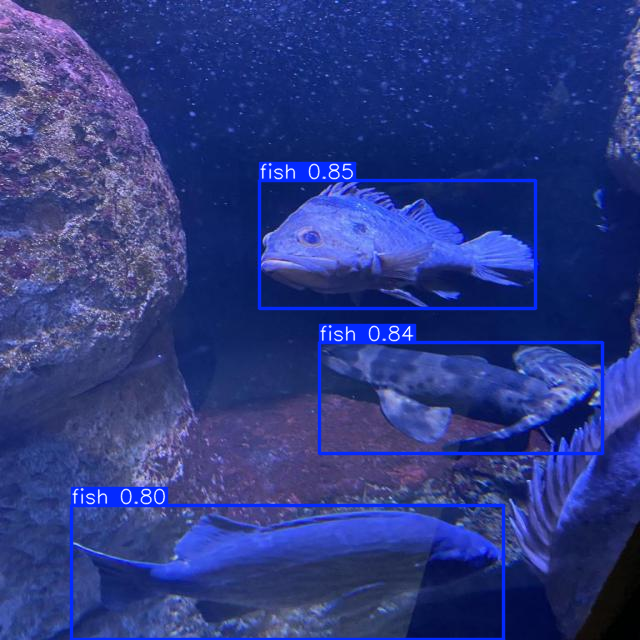

In [72]:
firts_results_save_dir_path = f"/kaggle/working/{firts_results.save_dir}"
firts_results_best_model_path = f"{firts_results_save_dir_path}/weights/best.pt"


first_best_model = YOLO(firts_results_best_model_path)

img="/kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
# img = "dataset/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
first_best_model.predict(img)[0].show()

Visual metrics of training and validating first model

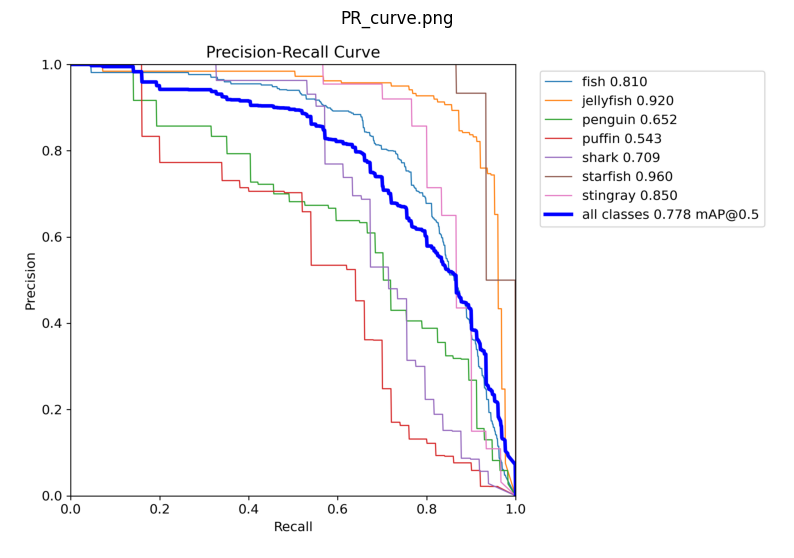

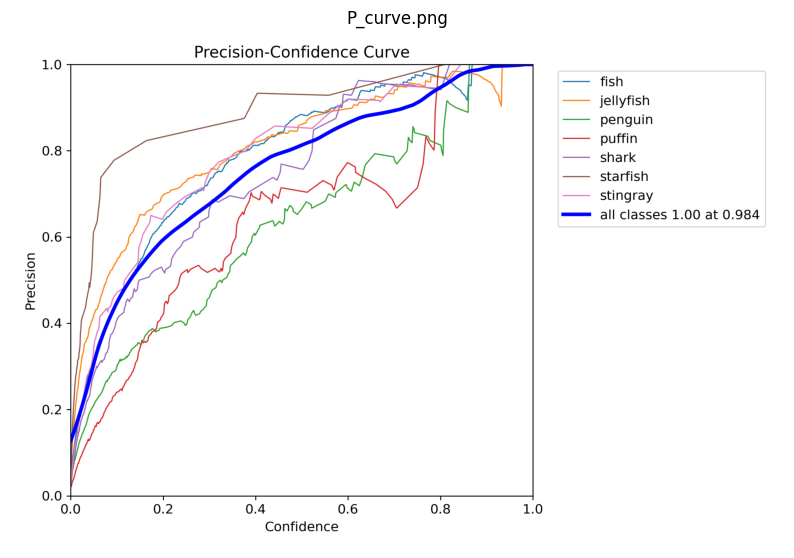

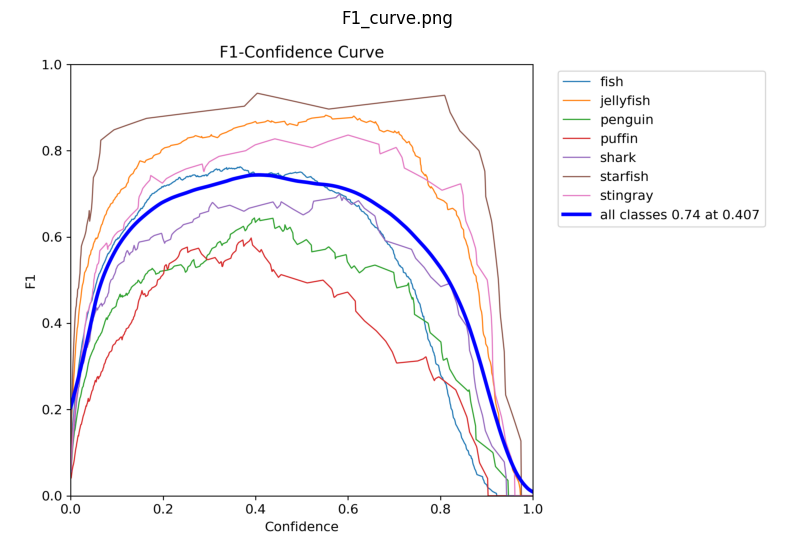

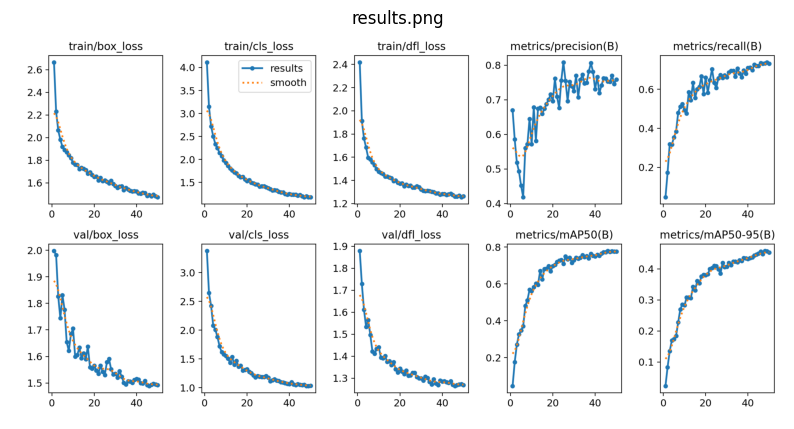

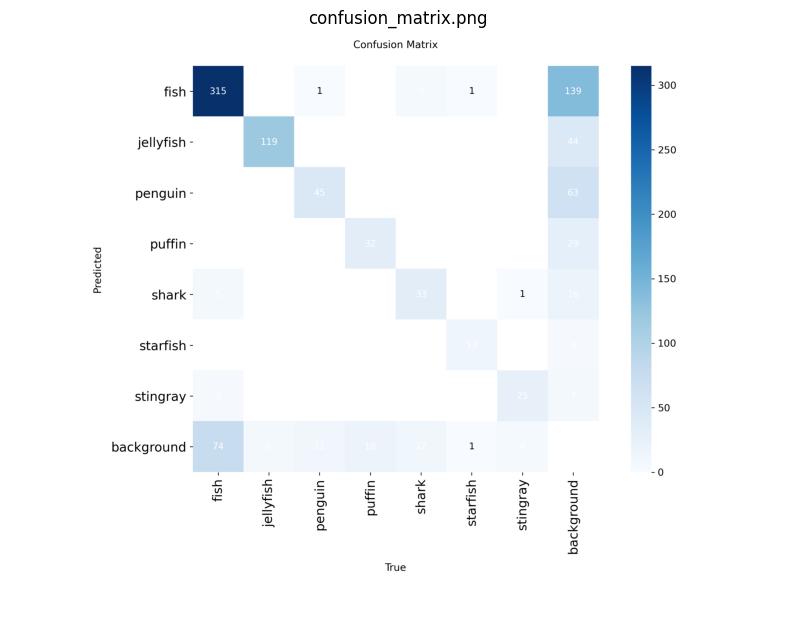

...

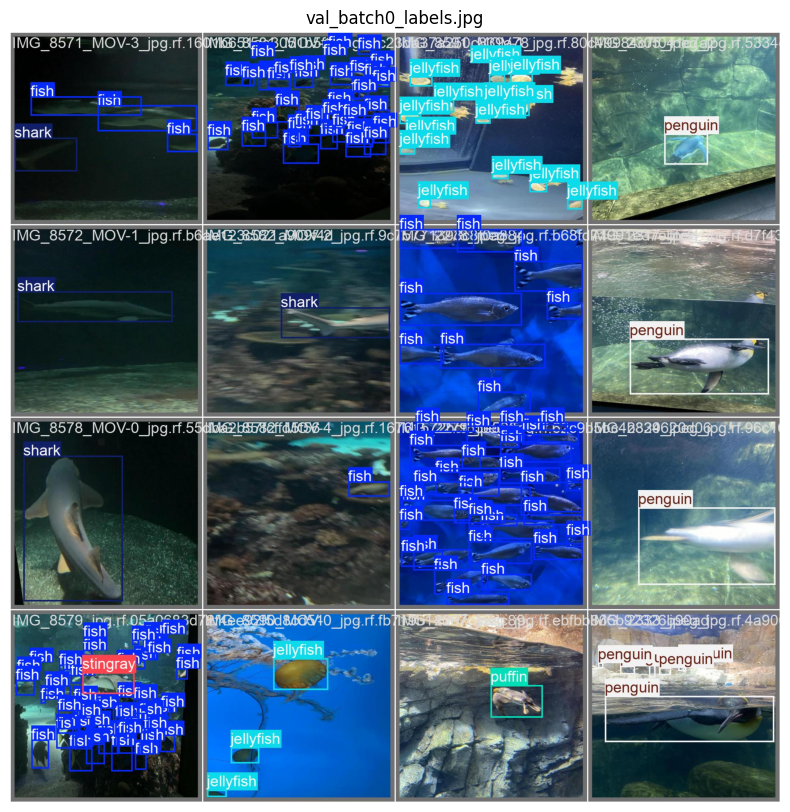

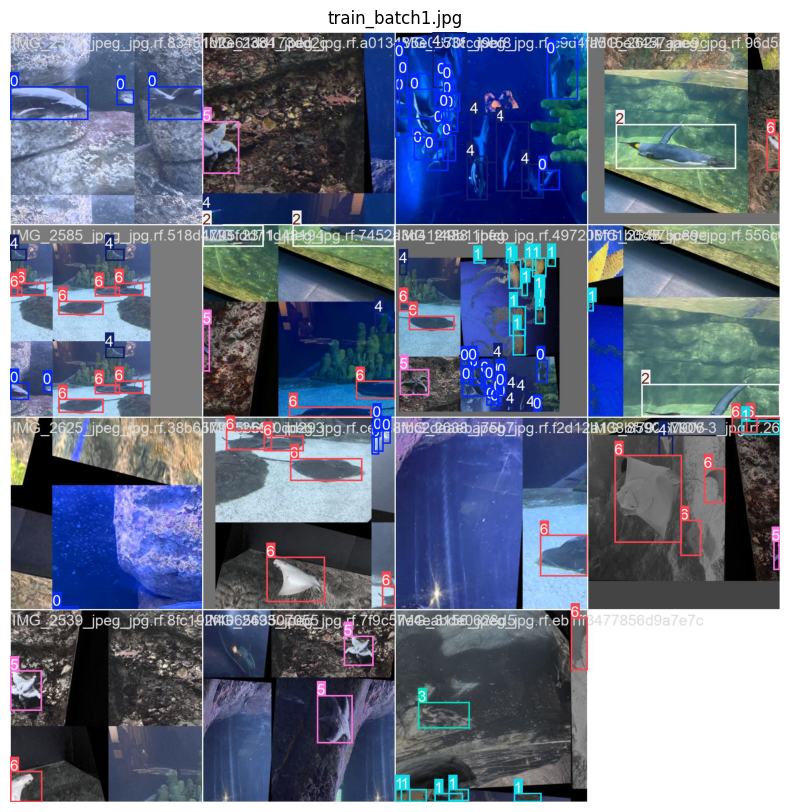

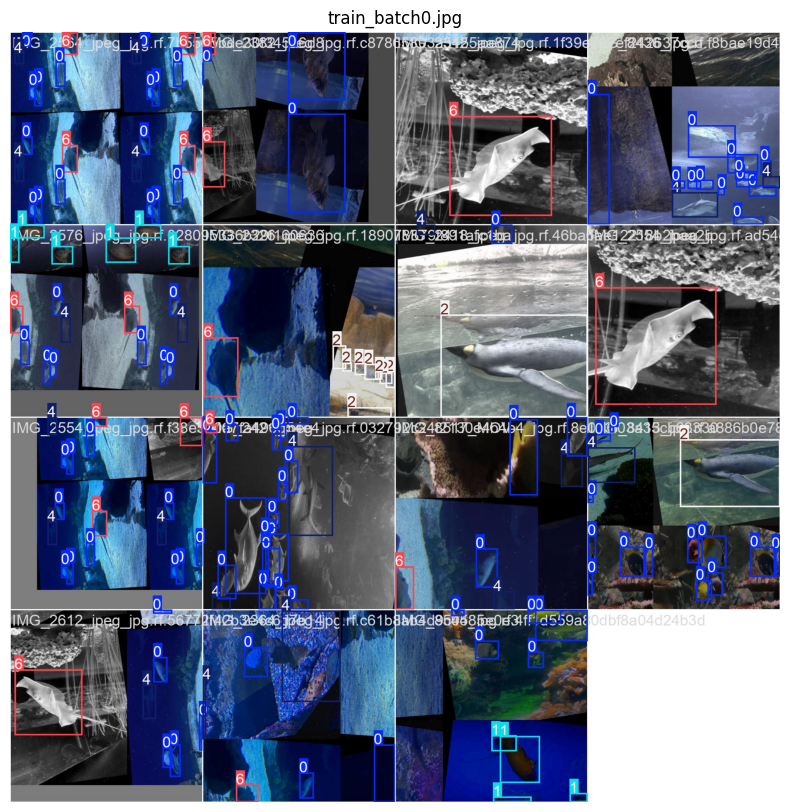

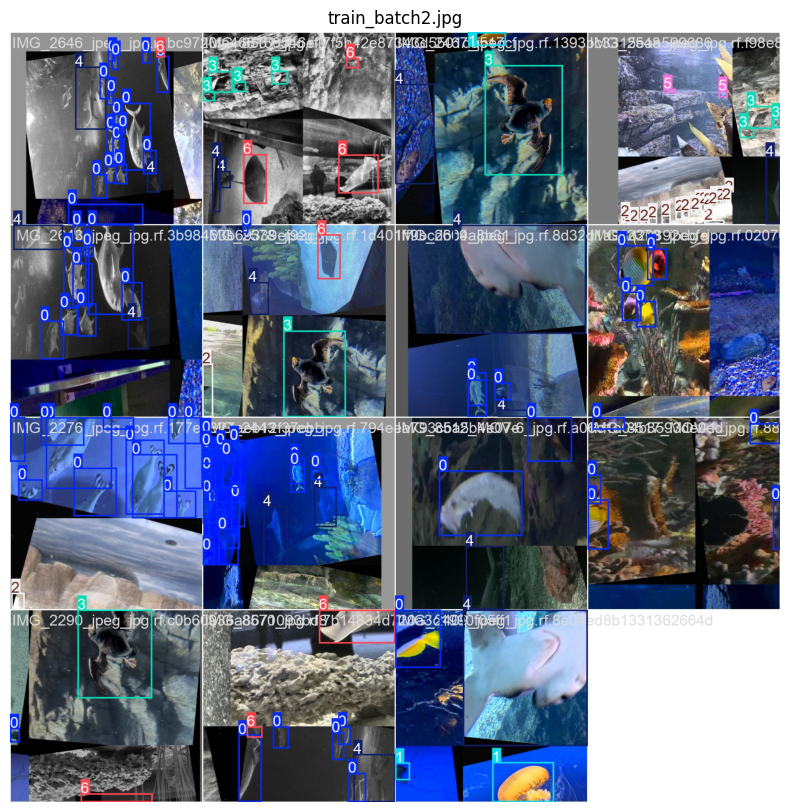

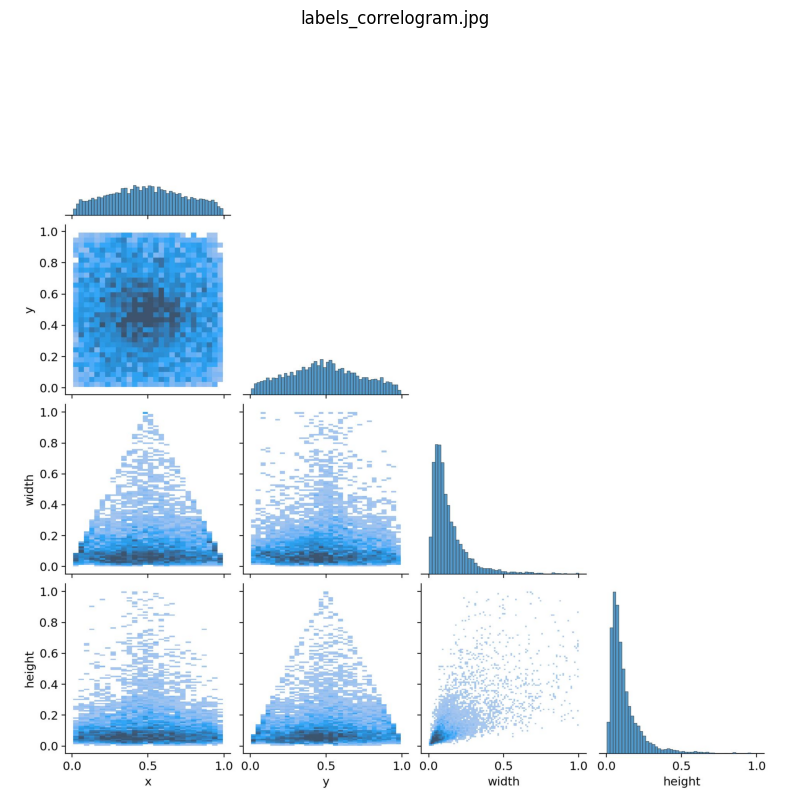

In [73]:
visualize_results(firts_results_save_dir_path)

Validating first model on test data

In [19]:
first_best_model_validation_results_test = first_best_model.val(split='test', verbose=True, plots=True)

Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 9.8±1.4 MB/s, size: 56.2 KB)


val: Scanning /kaggle/input/augumented-underwater-objects/test/labels... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<00:00, 207.07it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/augumented-underwater-objects/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.49it/s]


                   all        100        825      0.764      0.671      0.721      0.428
                  fish         41        319      0.815      0.627      0.754      0.429
             jellyfish         13        184      0.859      0.862      0.899      0.546
               penguin         14        141      0.782      0.611       0.71      0.316
                puffin         15         86      0.583      0.472      0.464      0.227
                 shark         20         45      0.813      0.774      0.794      0.511
              starfish         14         32       0.88      0.625      0.702      0.473
              stingray         13         18      0.616      0.722      0.726      0.494


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 3.0ms preprocess, 5.6ms inference, 0.0ms loss, 11.1ms postprocess per image
Results saved to runs/detect/val


In [74]:
first_best_model_validation_results_test.to_df()

,class_name,box-p,box-r,box-f1,box-map,box-map50,box-map75
0,fish,0.814636,0.626959,0.708581,0.427837,0.721271,0.455791
1,jellyfish,0.859227,0.862477,0.860849,0.427837,0.721271,0.455791
2,penguin,0.781980,0.610515,0.685691,0.427837,0.721271,0.455791
3,puffin,0.583273,0.472015,0.521779,0.427837,0.721271,0.455791
4,shark,0.813267,0.774334,0.793323,0.427837,0.721271,0.455791
5,starfish,0.880287,0.625000,0.730996,0.427837,0.721271,0.455791
6,stingray,0.615879,0.722222,0.664825,0.427837,0.721271,0.455791


In [75]:
first_best_model_validation_results_test_dir_path = f"/kaggle/working/{first_best_model_validation_results_test.save_dir}"
# visualize_results(first_best_model_validation_results_test_dir_path)

Target metrics value

In [76]:
print(f"Value of target metrics(map50) on val data = {firts_results.box.map50:.4f}")
print(f"Value of target metrics(map50) on test data = {first_best_model_validation_results_test.box.map50:.4f}")

Value of target metrics(map50) on val data = 0.7779
Value of target metrics(map50) on test data = 0.7213


#### 2.5 Вторая итерация

Проведите процедуры для достижения высоких показателей (корректировка данных/гиперпараметров), сделайте вывод


In [48]:
second_model = YOLO("yolo11n.pt")

data_kaggel_path = "/kaggle/input/augumented-underwater-objects/data.yaml"
# data_local_path = "dataset/data.yaml"

second_results = second_model.train(
    data=data_kaggel_path,
    epochs=50,
    imgsz=640,
    plots=True,
    seed=42,
    cache='disk',
    batch=16, # changed to 16 from 15(auto)
    save=True,
    save_period=10,
    # close_mosaic=0,
    # changes from first model
    dropout=0.15,
    box=8, # was 7.5
    weight_decay=0.0009, # was 0.0005
    cos_lr=True,
    close_mosaic=10, # was 0
    
)

Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=8, cache=disk, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/kaggle/input/augumented-underwater-objects/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.15, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

train: Scanning /kaggle/input/augumented-underwater-objects/train/labels... 1311 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1311/1311 [00:01<00:00, 666.77it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/augumented-underwater-objects/train is not writeable, cache not saved.
WARNING ⚠️ train: Skipping caching images to disk, directory not writeable
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 1.9±1.0 ms, read: 77.7±17.0 MB/s, size: 58.8 KB)


val: Scanning /kaggle/input/augumented-underwater-objects/valid/labels... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<00:00, 597.88it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/augumented-underwater-objects/valid is not writeable, cache not saved.
WARNING ⚠️ val: Skipping caching images to disk, directory not writeable


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000909, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0009), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      3.19G      1.917      3.544      1.539        142        640: 100%|██████████| 82/82 [00:16<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.21it/s]

                   all        100        723      0.819     0.0593      0.152     0.0738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      3.55G       1.95      2.566       1.54        138        640: 100%|██████████| 82/82 [00:14<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.63it/s]

                   all        100        723      0.278      0.263      0.226      0.107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      3.55G      1.973      2.365      1.541        170        640: 100%|██████████| 82/82 [00:14<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.61it/s]

                   all        100        723      0.287      0.432      0.299      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      3.55G      1.961      2.266      1.531        163        640: 100%|██████████| 82/82 [00:15<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        100        723      0.493      0.337      0.369      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      3.77G      1.937      2.097      1.515        147        640: 100%|██████████| 82/82 [00:14<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.49it/s]

                   all        100        723      0.406      0.435      0.427      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      3.77G      1.935      2.024      1.538        187        640: 100%|██████████| 82/82 [00:15<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.47it/s]

                   all        100        723       0.58      0.452      0.502      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      3.77G      1.901      1.946      1.498        141        640: 100%|██████████| 82/82 [00:14<00:00,  5.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.64it/s]

                   all        100        723      0.551      0.478       0.54      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      3.77G      1.854      1.849      1.472        152        640: 100%|██████████| 82/82 [00:14<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.81it/s]

                   all        100        723      0.649       0.55      0.614        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      3.77G      1.822      1.828      1.467        135        640: 100%|██████████| 82/82 [00:14<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.95it/s]

                   all        100        723      0.588      0.499      0.552       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      3.77G      1.834      1.789      1.458        150        640: 100%|██████████| 82/82 [00:14<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.39it/s]

                   all        100        723      0.504      0.431       0.48      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      3.77G      1.801      1.693      1.434        179        640: 100%|██████████| 82/82 [00:14<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.61it/s]

                   all        100        723      0.655      0.571      0.622      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      3.77G      1.783      1.657      1.435         95        640: 100%|██████████| 82/82 [00:14<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.75it/s]

                   all        100        723       0.75      0.506       0.61      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      3.77G      1.782      1.618      1.425        152        640: 100%|██████████| 82/82 [00:14<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.77it/s]

                   all        100        723      0.632      0.608      0.628      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      3.77G      1.755      1.599      1.418        150        640: 100%|██████████| 82/82 [00:15<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.93it/s]

                   all        100        723      0.671      0.626      0.675      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      3.77G       1.74      1.548      1.403        146        640: 100%|██████████| 82/82 [00:14<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.09it/s]

                   all        100        723      0.583      0.585      0.621      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      3.77G      1.771      1.526      1.411        248        640: 100%|██████████| 82/82 [00:14<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.95it/s]

                   all        100        723      0.593       0.62      0.621      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      3.77G      1.712      1.476      1.394        185        640: 100%|██████████| 82/82 [00:14<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.13it/s]

                   all        100        723      0.694      0.614       0.71      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      3.77G       1.71      1.465      1.377        232        640: 100%|██████████| 82/82 [00:14<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.58it/s]

                   all        100        723      0.715      0.647      0.704       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      3.77G      1.705      1.449      1.378         98        640: 100%|██████████| 82/82 [00:14<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.48it/s]

                   all        100        723      0.783      0.663      0.753      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      3.77G      1.689      1.405      1.364        142        640: 100%|██████████| 82/82 [00:14<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.49it/s]

                   all        100        723       0.67      0.665      0.705      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      3.77G      1.665      1.377      1.357        206        640: 100%|██████████| 82/82 [00:14<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.42it/s]

                   all        100        723      0.783      0.614      0.721      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      3.77G      1.667      1.358      1.354        138        640: 100%|██████████| 82/82 [00:14<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.10it/s]

                   all        100        723      0.796      0.618      0.738       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      3.77G      1.648      1.319      1.351        217        640: 100%|██████████| 82/82 [00:14<00:00,  5.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.40it/s]

                   all        100        723      0.722      0.709      0.758      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      3.77G      1.647      1.309      1.349        126        640: 100%|██████████| 82/82 [00:14<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.14it/s]

                   all        100        723       0.74       0.66      0.746      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      3.77G      1.625      1.282      1.338        133        640: 100%|██████████| 82/82 [00:14<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.31it/s]

                   all        100        723      0.777      0.678      0.764      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      3.77G      1.617      1.251       1.32        126        640: 100%|██████████| 82/82 [00:14<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.90it/s]

                   all        100        723      0.824      0.642      0.756      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      3.77G      1.607       1.22       1.31        211        640: 100%|██████████| 82/82 [00:14<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.96it/s]

                   all        100        723      0.776      0.666      0.778      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      3.77G      1.573      1.208      1.299         91        640: 100%|██████████| 82/82 [00:14<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.46it/s]

                   all        100        723      0.794      0.686      0.764      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      3.77G      1.565      1.188      1.296         95        640: 100%|██████████| 82/82 [00:14<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.16it/s]

                   all        100        723      0.752      0.696      0.752      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      3.77G      1.551      1.169      1.286        184        640: 100%|██████████| 82/82 [00:14<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.34it/s]

                   all        100        723      0.817      0.664       0.76       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      3.77G      1.541      1.148       1.27        133        640: 100%|██████████| 82/82 [00:14<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.25it/s]

                   all        100        723      0.783      0.724      0.791      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      3.77G      1.538      1.139      1.272        136        640: 100%|██████████| 82/82 [00:14<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.23it/s]

                   all        100        723      0.761      0.725      0.779      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.77G      1.508      1.115      1.262        166        640: 100%|██████████| 82/82 [00:14<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.23it/s]

                   all        100        723      0.747      0.761      0.783      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.77G      1.498      1.097      1.258        230        640: 100%|██████████| 82/82 [00:14<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.96it/s]

                   all        100        723      0.767      0.751      0.797      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.77G      1.517      1.079      1.256        165        640: 100%|██████████| 82/82 [00:14<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]

                   all        100        723      0.786       0.71      0.784      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.77G       1.49      1.069      1.246        163        640: 100%|██████████| 82/82 [00:14<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.36it/s]

                   all        100        723      0.767      0.729      0.794      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      3.77G      1.494      1.061      1.237        160        640: 100%|██████████| 82/82 [00:14<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.99it/s]

                   all        100        723      0.766      0.727      0.787      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      3.77G      1.465       1.03      1.236        169        640: 100%|██████████| 82/82 [00:14<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.37it/s]

                   all        100        723      0.791      0.721      0.795      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.77G      1.471      1.031      1.233         95        640: 100%|██████████| 82/82 [00:14<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.46it/s]

                   all        100        723      0.775      0.727      0.794      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      3.77G      1.445      1.015      1.222        180        640: 100%|██████████| 82/82 [00:14<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.53it/s]

                   all        100        723      0.768       0.76      0.803      0.489


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.77G      1.457     0.9859      1.241        155        640: 100%|██████████| 82/82 [00:15<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.18it/s]

                   all        100        723      0.763      0.732      0.797      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.77G      1.415     0.9243      1.209         83        640: 100%|██████████| 82/82 [00:14<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.25it/s]

                   all        100        723      0.785      0.731      0.795      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      3.77G      1.395     0.9144      1.203        150        640: 100%|██████████| 82/82 [00:14<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.41it/s]

                   all        100        723      0.782      0.731      0.792       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      3.77G      1.401     0.9022       1.21         96        640: 100%|██████████| 82/82 [00:14<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.19it/s]

                   all        100        723      0.774      0.746      0.795      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.77G      1.387     0.8975        1.2        115        640: 100%|██████████| 82/82 [00:14<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.18it/s]

                   all        100        723      0.791      0.744      0.801      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      3.77G      1.384     0.8844      1.202        149        640: 100%|██████████| 82/82 [00:14<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.31it/s]

                   all        100        723      0.783      0.748      0.803       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.77G      1.375     0.8728      1.194         97        640: 100%|██████████| 82/82 [00:14<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.79it/s]

                   all        100        723       0.77      0.767      0.804       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.77G       1.36     0.8814      1.198        110        640: 100%|██████████| 82/82 [00:14<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.72it/s]

                   all        100        723      0.772       0.75      0.801      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      3.77G      1.373     0.8799      1.196        100        640: 100%|██████████| 82/82 [00:13<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.09it/s]

                   all        100        723      0.777      0.739      0.805      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.77G      1.364     0.8661      1.186        158        640: 100%|██████████| 82/82 [00:13<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  5.57it/s]

                   all        100        723      0.802      0.733      0.807      0.484



50 epochs completed in 0.218 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 5.5MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]


                   all        100        723      0.768       0.76      0.803      0.489
                  fish         54        397      0.817      0.791      0.845      0.485
             jellyfish          7        125      0.807      0.896      0.919      0.538
               penguin         11         57      0.649      0.719      0.734      0.322
                puffin         11         50        0.7        0.5      0.605      0.317
                 shark         23         49      0.767      0.612      0.672      0.415
              starfish         10         15      0.849      0.933      0.947      0.718
              stingray         20         30      0.788      0.866      0.898      0.627


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 2.4ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to runs/detect/train3


In [77]:
second_results.to_df()

,class_name,box-p,box-r,box-f1,box-map,box-map50,box-map75
0,fish,0.817056,0.790932,0.803782,0.488809,0.802864,0.511564
1,jellyfish,0.807363,0.896000,0.849375,0.488809,0.802864,0.511564
2,penguin,0.649448,0.719298,0.682591,0.488809,0.802864,0.511564
3,puffin,0.699502,0.500000,0.583160,0.488809,0.802864,0.511564
4,shark,0.766697,0.612245,0.680821,0.488809,0.802864,0.511564
5,starfish,0.848592,0.933333,0.888948,0.488809,0.802864,0.511564
6,stingray,0.787649,0.865511,0.824747,0.488809,0.802864,0.511564


/kaggle/working/runs/detect/train3 /kaggle/working/runs/detect/train3/weights/best.pt

image 1/1 /kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg: 640x640 3 fishs, 10.6ms
Speed: 1.6ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


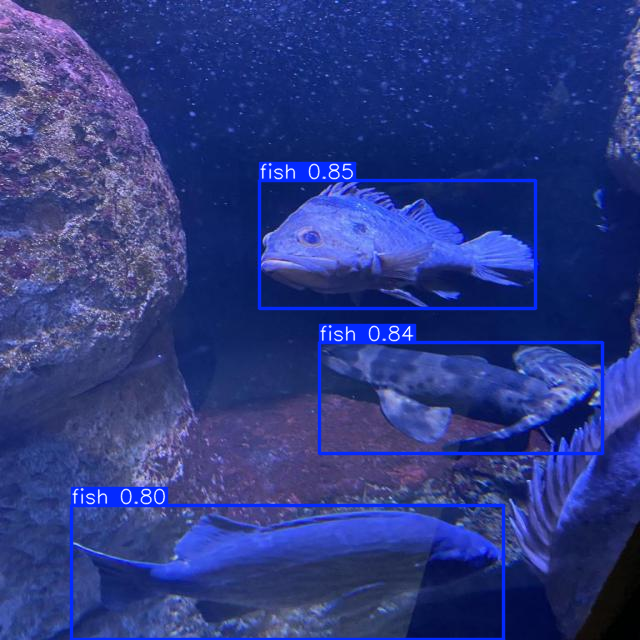

In [78]:
second_results_save_dir_path = f"/kaggle/working/{second_results.save_dir}"
second_results_best_model_path = f"{second_results_save_dir_path}/weights/best.pt"
print(second_results_save_dir_path, second_results_best_model_path)

second_best_model = YOLO(second_results_best_model_path)


img="/kaggle/input/augumented-underwater-objects/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
# img = "dataset/test/images/IMG_2371_jpeg_jpg.rf.8ae6076cb199a7f274e795252e38dab0.jpg"
first_best_model.predict(img)[0].show()

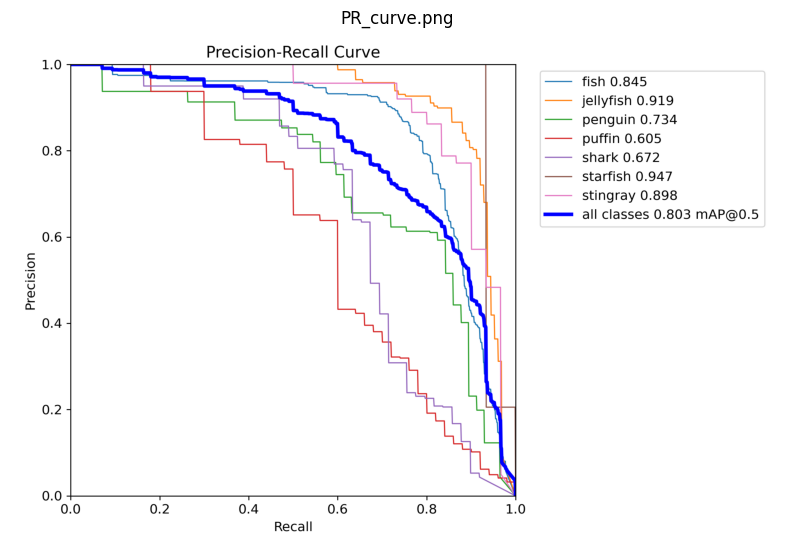

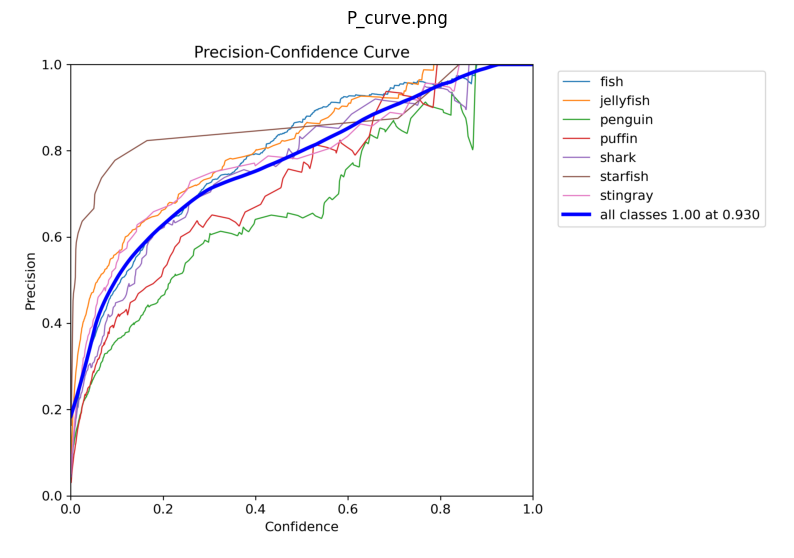

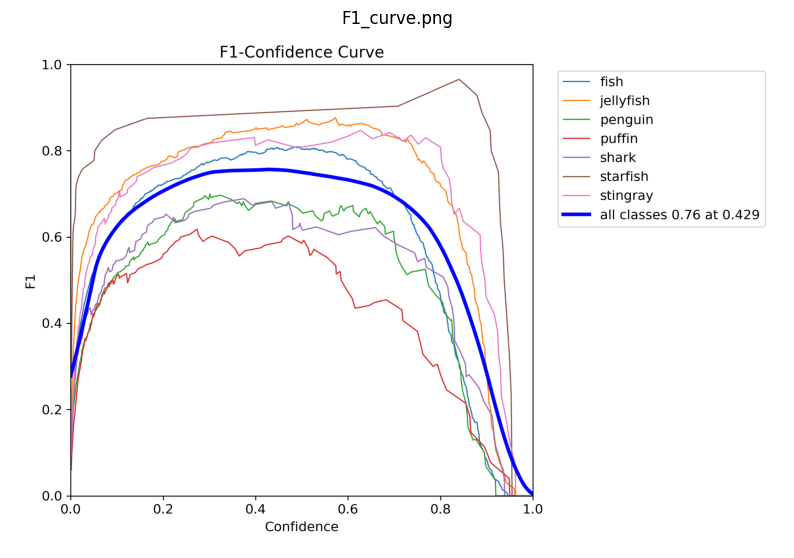

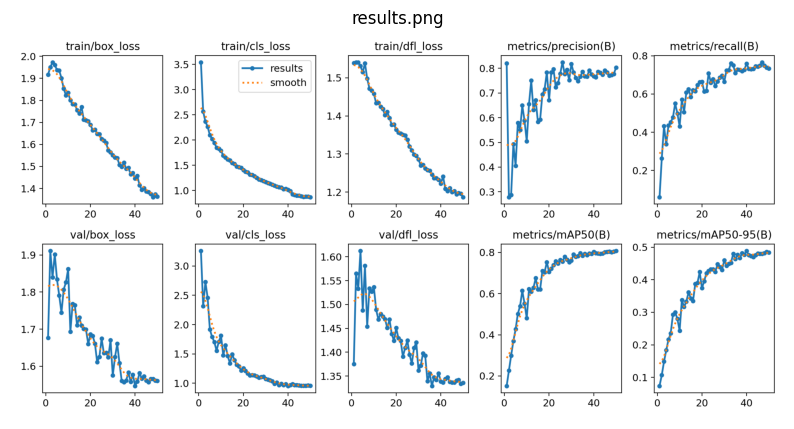

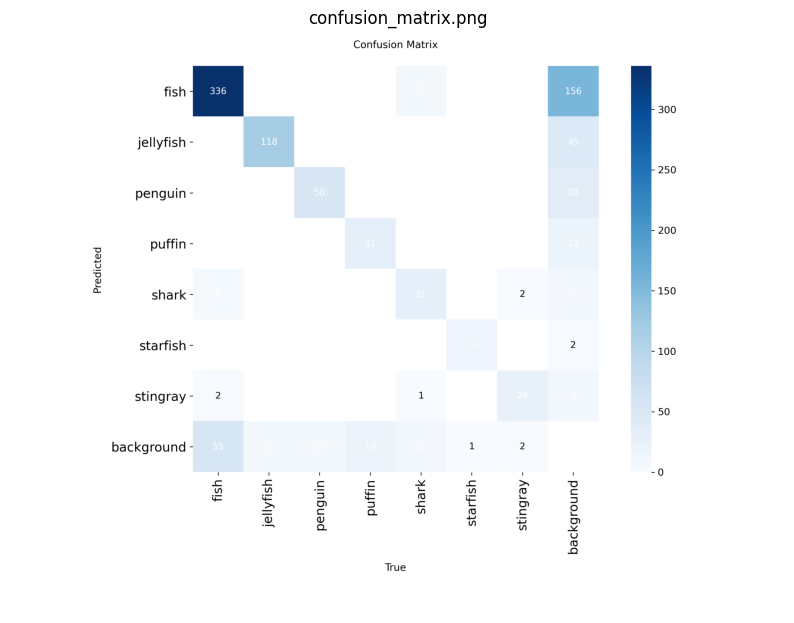

...

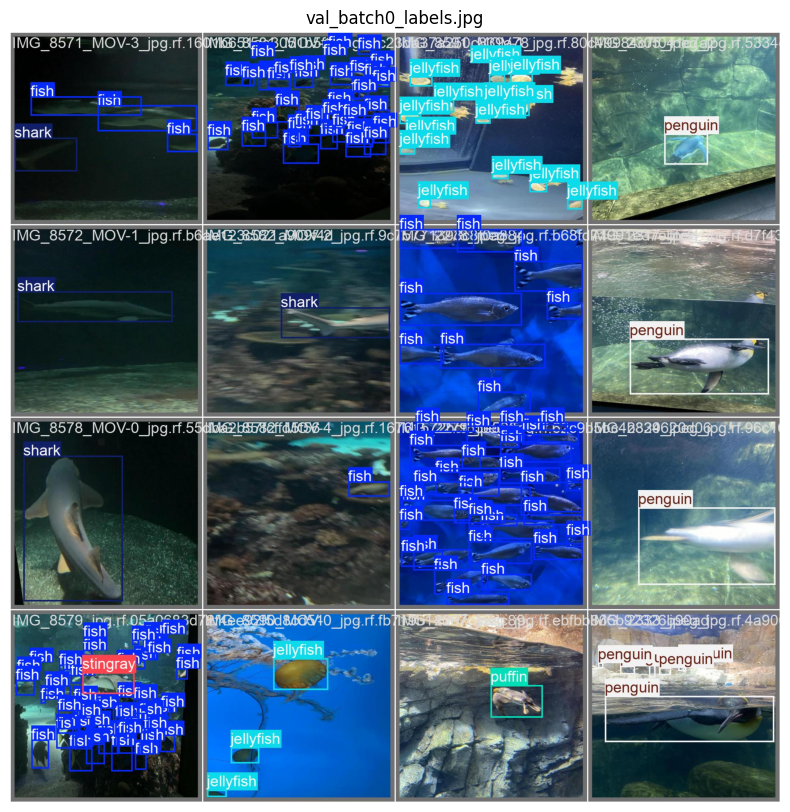

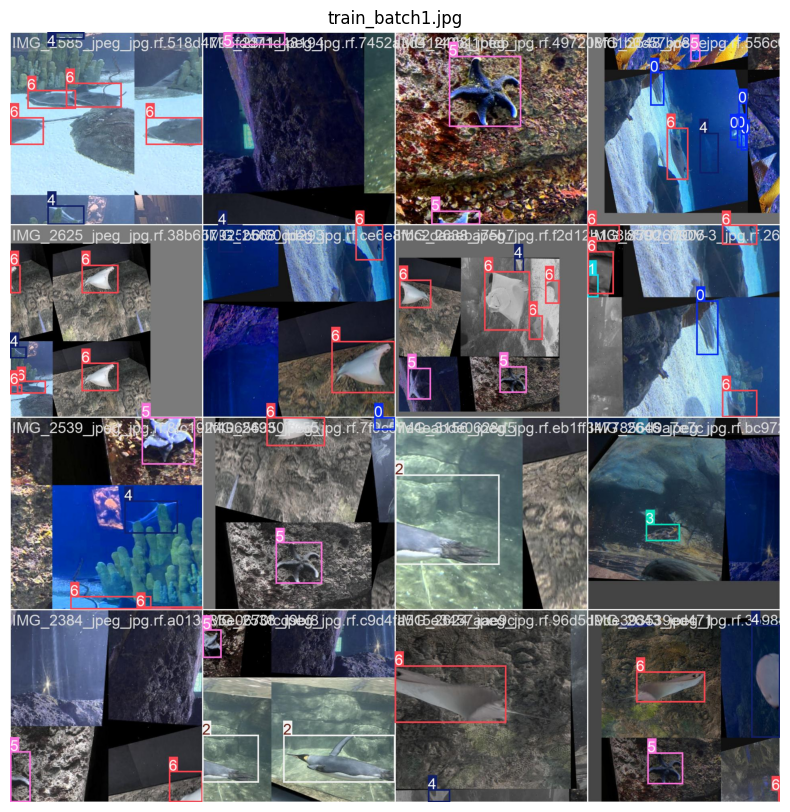

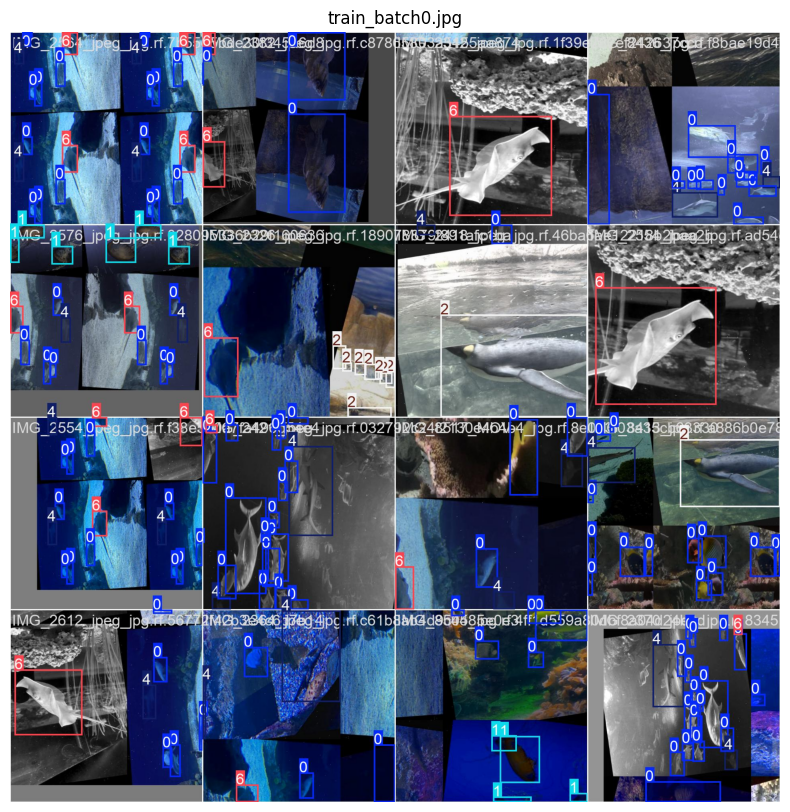

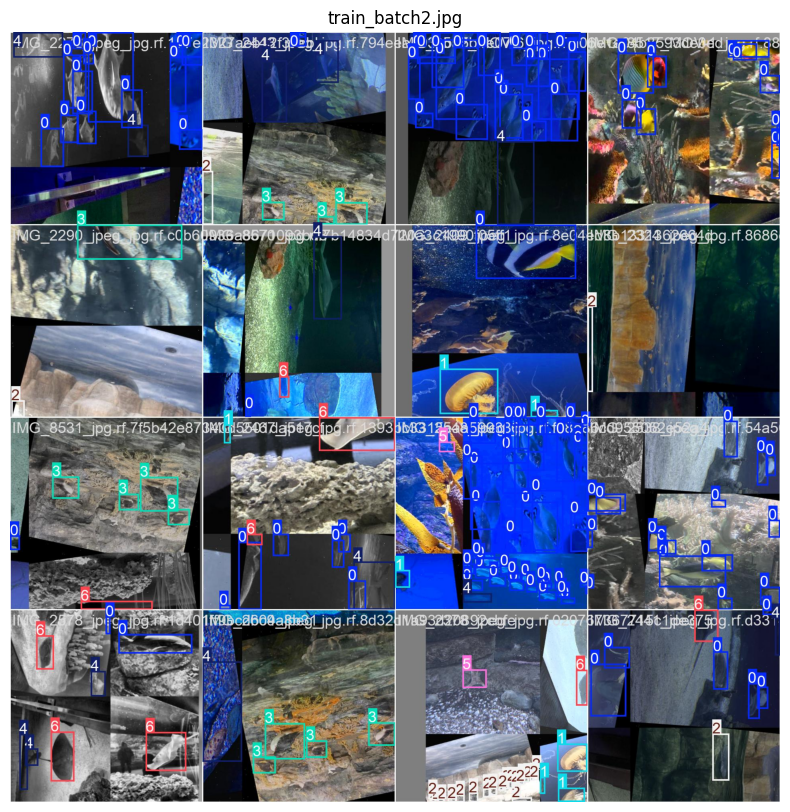

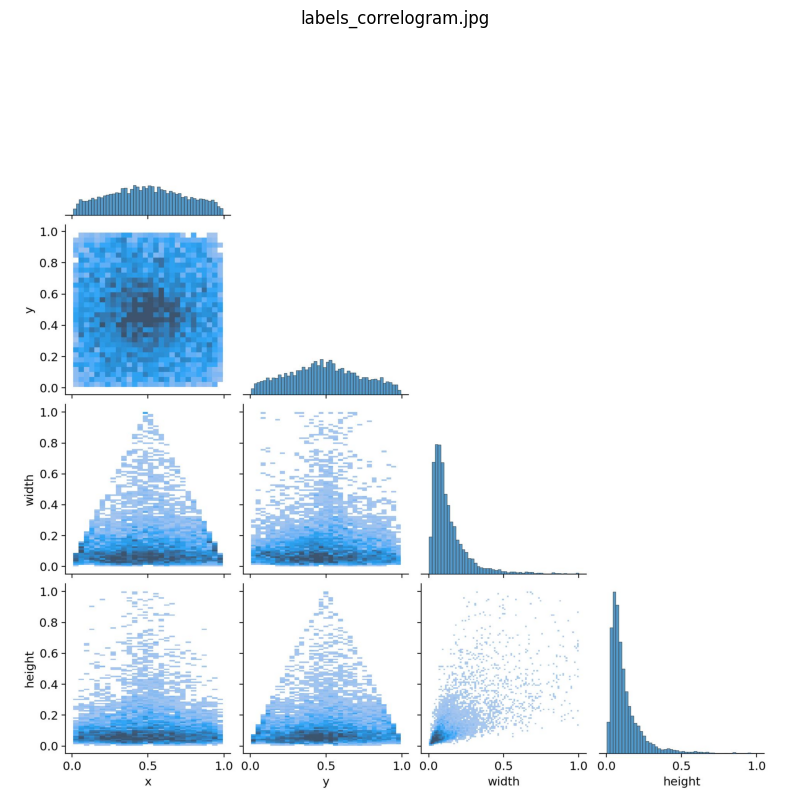

In [79]:
visualize_results(second_results_save_dir_path)

In [56]:
second_best_model_validation_results_test = second_best_model.val(split='test', verbose=True, plots=True)

Ultralytics 8.3.140 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 1.4±0.1 ms, read: 90.6±40.3 MB/s, size: 55.1 KB)


val: Scanning /kaggle/input/augumented-underwater-objects/test/labels... 100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 100/100 [00:00<00:00, 558.60it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/augumented-underwater-objects/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.44it/s]


                   all        100        825      0.737       0.73      0.772       0.45
                  fish         41        319      0.736       0.74      0.782      0.434
             jellyfish         13        184      0.817      0.837      0.901      0.543
               penguin         14        141      0.685      0.695      0.693      0.288
                puffin         15         86      0.669      0.493      0.533      0.241
                 shark         20         45      0.693      0.778      0.833      0.541
              starfish         14         32      0.886      0.731      0.822      0.518
              stingray         13         18       0.67      0.833      0.841      0.583


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 3.1ms preprocess, 9.0ms inference, 0.0ms loss, 7.6ms postprocess per image
Results saved to runs/detect/val2


In [80]:
second_best_model_validation_results_test.to_df()

,class_name,box-p,box-r,box-f1,box-map,box-map50,box-map75
0,fish,0.736246,0.739812,0.738025,0.449706,0.772007,0.460973
1,jellyfish,0.816858,0.836957,0.826785,0.449706,0.772007,0.460973
2,penguin,0.684891,0.695035,0.689926,0.449706,0.772007,0.460973
3,puffin,0.668641,0.492781,0.567397,0.449706,0.772007,0.460973
4,shark,0.692995,0.777778,0.732943,0.449706,0.772007,0.460973
5,starfish,0.886290,0.730995,0.801187,0.449706,0.772007,0.460973
6,stingray,0.670466,0.833333,0.743080,0.449706,0.772007,0.460973


In [61]:
second_best_model_validation_results_test_dir_path = f"/kaggle/working/{second_best_model_validation_results_test.save_dir}"
# visualize_results(second_best_model_validation_results_test_dir_path)

Comparision with first model on target metric

In [81]:
print('First model\n')
print(f"Value of target metrics(map50) on val data = {firts_results.box.map50:.4f}")
print(f"Value of target metrics(map50) on test data = {first_best_model_validation_results_test.box.map50:.4f}")
print('\nSecond model\n')
print(f"Value of target metrics(map50) on val data = {second_results.box.map50:.4f}")
print(f"Value of target metrics(map50) on test data = {second_best_model_validation_results_test.box.map50:.4f}")

First model

Value of target metrics(map50) on val data = 0.7779
Value of target metrics(map50) on test data = 0.7213

Second model

Value of target metrics(map50) on val data = 0.8029
Value of target metrics(map50) on test data = 0.7720
